# Machine Learning Analysis

## <span style="color:red;">Remarks:</span>
- I will adopt the metric average_precision_score to select the best model (Borgne et al., 2022).
- I will use Logistic Regression, RandomForestClassifier, and XGBClassifier. I chose Logistic Regression for its simplicity, and the other two because they are state-of-the-art approaches for this kind of analysis (Borgne et al., 2022).

- Average precision deals well with imbalance data (Borgne et al., 2022).

# Table of Contents
1. [Packages and Data Importation](#Packages-and-Data-Importation)  
2. [Train and Test Datasets](#Train-and-Test-Datasets)
3. [Preprocessing Data](#Preprocessing-Data)
    1. [Logistic Regression](#Logistic-Regression-1)
    2. [XGBooster](#XGBooster-1)
    3. [Random Forest](#Random-Forest-1)
4. [Exploring Imbalance](#Exploring-Imbalance)
    1. [Logistic Regression](#Logistic-Regression-2)
    2. [XGBooster](#XGBooster-2)
    3. [Random Forest](#Random-Forest-2)
5. [Exploring Hyperparameters](#Exploring-Hyperparameters)
    1. [Logistic Regression](#Logistic-Regression-3)
    2. [XGBooster](#XGBooster-3)
    3. [Random Forest](#Random-Forest-3)
6. [Final Results](#Final-Results)
7. [Deploy](#Deploy)
8. [References](#References)


# Packages and Data Importation

In [1]:
import joblib
import matplotlib.pyplot as plt
import numpy as np
import optuna
import pandas as pd
import plotly
import seaborn as sns
import time
import xgboost

from imblearn.combine import SMOTETomek

from imblearn.pipeline import Pipeline as ImbPipeline

from optuna.importance import FanovaImportanceEvaluator

from optuna.visualization import plot_optimization_history, plot_slice

from sklearn.compose import ColumnTransformer

from sklearn.linear_model import LogisticRegression

from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import average_precision_score

from sklearn.model_selection import (
    cross_val_score,
    GridSearchCV, 
    PredefinedSplit,
)

from sklearn.pipeline import Pipeline

from sklearn.preprocessing import (
    OneHotEncoder,
    PowerTransformer,
    QuantileTransformer,
    RobustScaler,
)


from src.config import (
    CLEAN_DATA,
    DATA_FOLDER,
    DEPLOYED_MODEL,
    PALETTE,
    SCATTER_ALPHA,
    RANDOM_STATE,
)

from src.models import (
    grid_search_cv_model,
)

#global options
sns.set_theme(style='dark', palette='colorblind', context='notebook')
pd.set_option('display.max_columns', None)

In [2]:
df = pd.read_parquet(CLEAN_DATA)
df

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class,Transaction_rate
0,0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0,high
1,0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0,high
2,1,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0,high
3,1,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0,high
4,2,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798279,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
283721,172786,-11.881118,10.071785,-9.834784,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,4.356170,-1.593105,2.711941,-0.689256,4.626942,-0.924459,1.107641,1.991691,0.510632,-0.682920,1.475829,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0,high
283722,172787,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,-0.975926,-0.150189,0.915802,1.214756,-0.675143,1.164931,-0.711757,-0.025693,-1.221179,-1.545556,0.059616,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0,high
283723,172788,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,-0.484782,0.411614,0.063119,-0.183699,-0.510602,1.329283,0.140716,0.313502,0.395652,-0.577252,0.001396,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0,high
283724,172788,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,-0.399126,-1.933849,-0.962886,-1.042082,0.449624,1.962563,-0.608577,0.509928,1.113981,2.897849,0.127434,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0,high


# Train and Test Datasets

I will split the data into train and test sets based on temporal order, using the first day as the training dataset and the second day as the test dataset.

In [6]:
# defining the type of the features
feature_dict = {
    'category': ['Transaction_rate'],
    'numeric': list(df.columns[~df.columns.isin(['Time','Class','Transaction_rate'])]),
    'time': ['Time'],
    'target': ['Class'],
}

In [7]:
#defining X and y
X = df.drop(columns=feature_dict['target'] + feature_dict['time'])
y = df[feature_dict['target']].to_numpy().ravel()

In [8]:
# Split the data into train and test based on temporal order (one day train and one day test)
split_time_threshold = 86400  # Define the time threshold
train_indices = df[df['Time'] <= split_time_threshold].index

# Define the cross-validation splitting strategy for GridSearchCV (i.e., day one to train and day two to test)
test_fold = [-1 if i in train_indices else 0 for i in range(len(df))]
custom_split = PredefinedSplit(test_fold)

# Preprocessing Data

## <span style="color:red;">Procedures:</span>
- Features that I identified as normally distributed during the EDA will not be transformed.
- I will adopt three different preprocessing strategies:
    - Use only `OneHotEncoder` on the categorical feature and `RobustScaler` on `Amount`, as it is on a different scale.
    - Use `OneHotEncoder` on the categorical feature and `PowerTransformer` on the numeric features.
    - Use `OneHotEncoder` on the categorical feature and `QuantileTransformer` on the numeric features.

In [16]:
preprocessor_dict = {
    'one_hot_encoder': feature_dict['category'],
    'power_transformer': [item for item in feature_dict['numeric'] if item not in ['V13','V15','V19','V24','V26']],
    'quantile_transformer': [item for item in feature_dict['numeric'] if item not in ['V13','V15','V19','V24','V26']],    
}

In [18]:
preprocessor_ohe_robust_amount = ColumnTransformer(
    transformers=[
        ("one_hot", OneHotEncoder(drop="first"), preprocessor_dict['one_hot_encoder']),
        ("robust", RobustScaler(), ['Amount']),
    ],
    remainder="passthrough",
    force_int_remainder_cols=False,
    
)

preprocessor_ohe_power = ColumnTransformer(
    transformers=[
        ("one_hot", OneHotEncoder(drop="first"), preprocessor_dict['one_hot_encoder']),
        ("power_transformer", PowerTransformer(), preprocessor_dict['power_transformer']),
    ],
    remainder="passthrough",
    force_int_remainder_cols=False,
    
)

preprocessor_ohe_quantile = ColumnTransformer(
    transformers=[
        ("one_hot", OneHotEncoder(drop="first"), preprocessor_dict['one_hot_encoder']),
        ("quantile_transformer", QuantileTransformer(output_distribution='normal', random_state=RANDOM_STATE), preprocessor_dict['quantile_transformer']),
    ],
    remainder="passthrough",
    force_int_remainder_cols=False,
    
)

In [13]:
# defining the dictionary with parameters names for the GridSearchCV()parameters names
param_grid = {
    "preprocessor": [preprocessor_ohe_robust_amount, preprocessor_ohe_quantile, preprocessor_ohe_power],    
}

### Logistic Regression <span style="opacity: 0.0;">1</span>

In [20]:
grid_search = grid_search_cv_model(
    model=LogisticRegression(random_state=RANDOM_STATE, max_iter=1_000), #needs to have a valid variable for it to run.
    preprocessor=preprocessor_ohe_power, #needs to have a valid variable for it to run.
    target_transformer=None, 
    param_grid=param_grid,
    cv=custom_split, 
    scoring='average_precision',
)

grid_search.fit(X,y)

Fitting 1 folds for each of 3 candidates, totalling 3 fits


GridSearchCV(cv=PredefinedSplit(test_fold=array([-1, -1, ...,  0,  0])),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(force_int_remainder_cols=False,
                                                          remainder='passthrough',
                                                          transformers=[('one_hot',
                                                                         OneHotEncoder(drop='first'),
                                                                         ['Transaction_rate']),
                                                                        ('power_transformer',
                                                                         PowerTransformer(),
                                                                         ['V1',
                                                                          'V2',
                                                                          'V3',
                                                                          'V4',
                                                                          'V5',
                                                                          'V6',
                                                                          'V7',
                                                                          'V8',
                                                                          'V9',
                                                                          'V10',
                                                                          'V...
                                          ColumnTransformer(force_int_remainder_cols=False,
                                                            remainder='passthrough',
                                                            transformers=[('one_hot',
                                                                           OneHotEncoder(drop='first'),
                                                                           ['Transaction_rate']),
                                                                          ('power_transformer',
                                                                           PowerTransformer(),
                                                                           ['V1',
                                                                            'V2',
                                                                            'V3',
                                                                            'V4',
                                                                            'V5',
                                                                            'V6',
                                                                            'V7',
                                                                            'V8',
                                                                            'V9',
                                                                            'V10',
                                                                            'V11',
                                                                            'V12',
                                                                            'V14',
                                                                            'V16',
                                                                            'V17',
                                                                            'V18',
                                                                            'V20',
                                                                            'V21',
                                                                            'V22',
                                                                            'V23',
                                         

In [75]:
df_scores_gridsearchcv= pd.DataFrame(grid_search.cv_results_)

df_scores = df_scores_gridsearchcv[['params', 'mean_test_score']].sort_values(by='mean_test_score', ascending=False)

df_scores.rename(columns={
    'params': 'Preprocessor Applied',
    'mean_test_score': 'Average Precision'
}, inplace=True)

df_scores.loc[0,'Preprocessor Applied'] = 'OneHotEncoder and RobustScaler on Amount'
df_scores.loc[1,'Preprocessor Applied'] = 'OneHotEncoder and QuantileTransformer'
df_scores.loc[2,'Preprocessor Applied'] = 'OneHotEncoder and PowerTransformer'

df_scores

,Preprocessor Applied,Average Precision
1,OneHotEncoder and QuantileTransformer,0.803806
2,OneHotEncoder and PowerTransformer,0.709263
0,OneHotEncoder and RobustScaler on Amount,0.621932


### XGBooster <span style="opacity: 0.0;">1</span>

In [78]:
grid_search = grid_search_cv_model(
    model=xgboost.XGBClassifier(random_state=RANDOM_STATE,n_jobs=-1), #needs to have a valid variable for it to run.
    preprocessor=preprocessor_ohe_power, #needs to have a valid variable for it to run.
    target_transformer=None, 
    param_grid=param_grid,
    cv=custom_split, 
    scoring='average_precision',
)

grid_search.fit(X,y)

Fitting 1 folds for each of 3 candidates, totalling 3 fits


GridSearchCV(cv=PredefinedSplit(test_fold=array([-1, -1, ...,  0,  0])),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(force_int_remainder_cols=False,
                                                          remainder='passthrough',
                                                          transformers=[('one_hot',
                                                                         OneHotEncoder(drop='first'),
                                                                         ['Transaction_rate']),
                                                                        ('power_transformer',
                                                                         PowerTransformer(),
                                                                         ['V1',
                                                                          'V2',
                                                                          'V3',
                                                                          'V4',
                                                                          'V5',
                                                                          'V6',
                                                                          'V7',
                                                                          'V8',
                                                                          'V9',
                                                                          'V10',
                                                                          'V...
                                          ColumnTransformer(force_int_remainder_cols=False,
                                                            remainder='passthrough',
                                                            transformers=[('one_hot',
                                                                           OneHotEncoder(drop='first'),
                                                                           ['Transaction_rate']),
                                                                          ('power_transformer',
                                                                           PowerTransformer(),
                                                                           ['V1',
                                                                            'V2',
                                                                            'V3',
                                                                            'V4',
                                                                            'V5',
                                                                            'V6',
                                                                            'V7',
                                                                            'V8',
                                                                            'V9',
                                                                            'V10',
                                                                            'V11',
                                                                            'V12',
                                                                            'V14',
                                                                            'V16',
                                                                            'V17',
                                                                            'V18',
                                                                            'V20',
                                                                            'V21',
                                                                            'V22',
                                                                            'V23',
                                         

In [79]:
df_scores_gridsearchcv= pd.DataFrame(grid_search.cv_results_)

df_scores = df_scores_gridsearchcv[['params', 'mean_test_score']].sort_values(by='mean_test_score', ascending=False)

df_scores.rename(columns={
    'params': 'Preprocessor Applied',
    'mean_test_score': 'Average Precision'
}, inplace=True)

df_scores.loc[0,'Preprocessor Applied'] = 'OneHotEncoder and RobustScaler on Amount'
df_scores.loc[1,'Preprocessor Applied'] = 'OneHotEncoder and QuantileTransformer'
df_scores.loc[2,'Preprocessor Applied'] = 'OneHotEncoder and PowerTransformer'

df_scores

,Preprocessor Applied,Average Precision
1,OneHotEncoder and QuantileTransformer,0.790568
2,OneHotEncoder and PowerTransformer,0.782711
0,OneHotEncoder and RobustScaler on Amount,0.767504


### Random Forest <span style="opacity: 0.0;">1</span>

In [80]:
grid_search = grid_search_cv_model(
    model=RandomForestClassifier(random_state=RANDOM_STATE,n_jobs=-1), #needs to have a valid variable for it to run.
    preprocessor=preprocessor_ohe_power, #needs to have a valid variable for it to run.
    target_transformer=None, 
    param_grid=param_grid,
    cv=custom_split, 
    scoring='average_precision',
)

grid_search.fit(X,y)

Fitting 1 folds for each of 3 candidates, totalling 3 fits


GridSearchCV(cv=PredefinedSplit(test_fold=array([-1, -1, ...,  0,  0])),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(force_int_remainder_cols=False,
                                                          remainder='passthrough',
                                                          transformers=[('one_hot',
                                                                         OneHotEncoder(drop='first'),
                                                                         ['Transaction_rate']),
                                                                        ('power_transformer',
                                                                         PowerTransformer(),
                                                                         ['V1',
                                                                          'V2',
                                                                          'V3',
                                                                          'V4',
                                                                          'V5',
                                                                          'V6',
                                                                          'V7',
                                                                          'V8',
                                                                          'V9',
                                                                          'V10',
                                                                          'V...
                                          ColumnTransformer(force_int_remainder_cols=False,
                                                            remainder='passthrough',
                                                            transformers=[('one_hot',
                                                                           OneHotEncoder(drop='first'),
                                                                           ['Transaction_rate']),
                                                                          ('power_transformer',
                                                                           PowerTransformer(),
                                                                           ['V1',
                                                                            'V2',
                                                                            'V3',
                                                                            'V4',
                                                                            'V5',
                                                                            'V6',
                                                                            'V7',
                                                                            'V8',
                                                                            'V9',
                                                                            'V10',
                                                                            'V11',
                                                                            'V12',
                                                                            'V14',
                                                                            'V16',
                                                                            'V17',
                                                                            'V18',
                                                                            'V20',
                                                                            'V21',
                                                                            'V22',
                                                                            'V23',
                                         

In [81]:
df_scores_gridsearchcv= pd.DataFrame(grid_search.cv_results_)

df_scores = df_scores_gridsearchcv[['params', 'mean_test_score']].sort_values(by='mean_test_score', ascending=False)

df_scores.rename(columns={
    'params': 'Preprocessor Applied',
    'mean_test_score': 'Average Precision'
}, inplace=True)

df_scores.loc[0,'Preprocessor Applied'] = 'OneHotEncoder and RobustScaler on Amount'
df_scores.loc[1,'Preprocessor Applied'] = 'OneHotEncoder and QuantileTransformer'
df_scores.loc[2,'Preprocessor Applied'] = 'OneHotEncoder and PowerTransformer'

df_scores

,Preprocessor Applied,Average Precision
0,OneHotEncoder and RobustScaler on Amount,0.773161
2,OneHotEncoder and PowerTransformer,0.758206
1,OneHotEncoder and QuantileTransformer,0.749969


## <span style="color:red;">Remarks:</span>
- The preprocessor impacts Logistic Regression more intensely.
- Logistic Regression and XGBoost perform better with OneHotEncoder and QuantileTransformer, while Random Forest performs better with OneHotEncoder and RobustScaler on Amount.
    - After optimizing the hyperparameters of the XGBoost and Random Forest models, the effect of the preprocessor becomes negligible (see `ah_appendix.ipynb`).

# Exploring Imbalance

## <span style="color:red;">Remarks:</span>
- I will perform the analyses using only SMOTETomek, one of the benchmark approaches for handling imbalanced datasets (Fernández et al., 2018).

### Logistic Regression <span style="opacity: 0.0;">2</span>

In [106]:
smote_tomek = SMOTETomek(random_state=RANDOM_STATE)

model = LogisticRegression(random_state=RANDOM_STATE, max_iter=1_000)

#determine the pipeline
pipeline = ImbPipeline(steps=[
    ('preprocessor', preprocessor_ohe_quantile),  # Preprocessing step
    ('smote_tomek', smote_tomek),                 # SMOTETomek for combined oversampling and undersampling
    ('model', model)                   # Logistic regression model
])

# Define the GridSearchCV object
grid_search = GridSearchCV(
    estimator=pipeline,
    param_grid=param_grid,
    cv=custom_split,
    scoring='average_precision',
    n_jobs=-1,  # Use all available cores
    verbose=1   # Show progress during grid search
)

# Fit the grid search on the data
grid_search.fit(X, y)


df_scores_gridsearchcv= pd.DataFrame(grid_search.cv_results_)

df_scores = df_scores_gridsearchcv[['params', 'mean_test_score']].sort_values(by='mean_test_score', ascending=False)

df_scores.rename(columns={
    'params': 'Preprocessor Applied',
    'mean_test_score': 'Average Precision'
}, inplace=True)

df_scores.loc[0,'Preprocessor Applied'] = 'OneHotEncoder and RobustScaler on Amount'
df_scores.loc[1,'Preprocessor Applied'] = 'OneHotEncoder and QuantileTransformer'
df_scores.loc[2,'Preprocessor Applied'] = 'OneHotEncoder and PowerTransformer'

df_scores

Fitting 1 folds for each of 3 candidates, totalling 3 fits


,Preprocessor Applied,Average Precision
0,OneHotEncoder and RobustScaler on Amount,0.775756
2,OneHotEncoder and PowerTransformer,0.775018
1,OneHotEncoder and QuantileTransformer,0.756918


### XGBooster <span style="opacity: 0.0;">2</span>

In [120]:
smote_tomek = SMOTETomek(random_state=RANDOM_STATE)

model=xgboost.XGBClassifier(random_state=RANDOM_STATE,n_jobs=-1)

#determine the pipeline
pipeline = ImbPipeline(steps=[
    ('preprocessor', preprocessor_ohe_quantile),  # Preprocessing step
    ('smote_tomek', smote_tomek),                 # SMOTETomek for combined oversampling and undersampling
    ('model', model)                   # Logistic regression model
])

# Define the GridSearchCV object
grid_search = GridSearchCV(
    estimator=pipeline,
    param_grid=param_grid,
    cv=custom_split,
    scoring='average_precision',
    n_jobs=-1,  # Use all available cores
    verbose=1   # Show progress during grid search
)

# Fit the grid search on the data
grid_search.fit(X, y)


df_scores_gridsearchcv= pd.DataFrame(grid_search.cv_results_)

df_scores = df_scores_gridsearchcv[['params', 'mean_test_score']].sort_values(by='mean_test_score', ascending=False)

df_scores.rename(columns={
    'params': 'Preprocessor Applied',
    'mean_test_score': 'Average Precision'
}, inplace=True)

df_scores.loc[0,'Preprocessor Applied'] = 'OneHotEncoder and RobustScaler on Amount'
df_scores.loc[1,'Preprocessor Applied'] = 'OneHotEncoder and QuantileTransformer'
df_scores.loc[2,'Preprocessor Applied'] = 'OneHotEncoder and PowerTransformer'

df_scores

Fitting 1 folds for each of 3 candidates, totalling 3 fits


,Preprocessor Applied,Average Precision
1,OneHotEncoder and QuantileTransformer,0.748219
0,OneHotEncoder and RobustScaler on Amount,0.734094
2,OneHotEncoder and PowerTransformer,0.713550


### Random Forest <span style="opacity: 0.0;">2</span>

In [121]:
smote_tomek = SMOTETomek(random_state=RANDOM_STATE)

model=RandomForestClassifier(random_state=RANDOM_STATE,n_jobs=-1)

#determine the pipeline
pipeline = ImbPipeline(steps=[
    ('preprocessor', preprocessor_ohe_quantile),  # Preprocessing step
    ('smote_tomek', smote_tomek),                 # SMOTETomek for combined oversampling and undersampling
    ('model', model)                   # Logistic regression model
])

# Define the GridSearchCV object
grid_search = GridSearchCV(
    estimator=pipeline,
    param_grid=param_grid,
    cv=custom_split,
    scoring='average_precision',
    n_jobs=-1,  # Use all available cores
    verbose=1   # Show progress during grid search
)

# Fit the grid search on the data
grid_search.fit(X, y)


df_scores_gridsearchcv= pd.DataFrame(grid_search.cv_results_)

df_scores = df_scores_gridsearchcv[['params', 'mean_test_score']].sort_values(by='mean_test_score', ascending=False)

df_scores.rename(columns={
    'params': 'Preprocessor Applied',
    'mean_test_score': 'Average Precision'
}, inplace=True)

df_scores.loc[0,'Preprocessor Applied'] = 'OneHotEncoder and RobustScaler on Amount'
df_scores.loc[1,'Preprocessor Applied'] = 'OneHotEncoder and QuantileTransformer'
df_scores.loc[2,'Preprocessor Applied'] = 'OneHotEncoder and PowerTransformer'

df_scores

Fitting 1 folds for each of 3 candidates, totalling 3 fits


,Preprocessor Applied,Average Precision
2,OneHotEncoder and PowerTransformer,0.754757
1,OneHotEncoder and QuantileTransformer,0.747866
0,OneHotEncoder and RobustScaler on Amount,0.746566


## <span style="color:red;">Remarks:</span>
- As discussed in Borgne et al (2022), for the Average Precision correcting the imbalance is not beneficial.

# Exploring Hyperparameters

In [20]:
# number of trials in the optuna studies
# for the sake of brevity in this portfolio project, I will only use a reasonably large number without exploring whether another value would perform better.
n_trials = 150

#a more robust way to analyze parameter importance and allow seeding
evaluator = FanovaImportanceEvaluator(seed=RANDOM_STATE)

#creating an object to store the results to facilitate comparison
rows = []
# this object will contain the model designation, the Average Precision (value for the best trial), and the time (mean and standard deviation across all trials).

## Logistic Regression <span style="opacity: 0.0;">3</span>

In [23]:
preprocessor = preprocessor_ohe_quantile

### Model with default HPs values to use as reference

In [26]:
start_time = time.time()

model = LogisticRegression(
        max_iter=1000,
        random_state=RANDOM_STATE,
        n_jobs=-1
    )

# Create pipeline
pipeline_model = Pipeline([("preprocessor", preprocessor), ("model", model)])

score = cross_val_score(pipeline_model, X, y, n_jobs=-1, cv=custom_split, scoring='average_precision').mean()
total_time = time.time() - start_time
print(score, total_time)

0.8038063037370944 2.425928831100464


In [27]:
# adding the results to the 'row' for future comparison.
rows.append({"Model": "logistic_regression_default", "Average Precision": score, "Time (mean)": total_time , "Time (sd)": np.nan})

### Model to explore HPs and their values

In [31]:
#save or load the Optuna analysis
study_name = str(DATA_FOLDER/"logistic_regression_round1")
storage_name = f"sqlite:///{study_name}.db"
study = optuna.create_study(direction='maximize', sampler=optuna.samplers.TPESampler(seed=RANDOM_STATE), study_name=study_name, storage=storage_name, load_if_exists=True)

[I 2025-02-03 07:44:16,427] Using an existing study with name '/home/alexhubbe/MEGA/data_science/portfolio/fraud_project/data/logistic_regression_round1' instead of creating a new one.


In [75]:
def objective(trial):
    """
    Define a search space for a model's hyperparameters and optimize it using cross-validation.
    """
    start_time = time.time()

    # Initialize the  model with suggested hyperparameters
    model = LogisticRegression(
        penalty='elasticnet',
        C = trial.suggest_float('C', 1e-3, 1e3, log=True),
        l1_ratio=trial.suggest_float('l1_ratio', 0, 1),
        solver='saga',
        max_iter=1000,
        random_state=RANDOM_STATE,
        n_jobs=-1
    )

    # Create pipeline
    pipeline_model = Pipeline([("preprocessor", preprocessor), ("model", model)])
    
    # Perform cross-validation
    score = cross_val_score(pipeline_model, X, y, n_jobs=-1, cv=custom_split, scoring='average_precision').mean()
    
    trial.set_user_attr("trial_time", time.time() - start_time)
    
    return score

# Optimize
study.optimize(objective, n_trials=n_trials)

[I 2024-12-15 17:12:44,545] Trial 0 finished with value: 0.8119074596976659 and parameters: {'C': 0.1767016940294795, 'l1_ratio': 0.9507143064099162}. Best is trial 0 with value: 0.8119074596976659.
[I 2024-12-15 17:13:22,210] Trial 1 finished with value: 0.8008215926047597 and parameters: {'C': 24.658329458549105, 'l1_ratio': 0.5986584841970366}. Best is trial 0 with value: 0.8119074596976659.
[I 2024-12-15 17:13:26,445] Trial 2 finished with value: 0.8010856433506466 and parameters: {'C': 0.008632008168602538, 'l1_ratio': 0.15599452033620265}. Best is trial 0 with value: 0.8119074596976659.
[I 2024-12-15 17:13:30,919] Trial 3 finished with value: 0.7875203571249981 and parameters: {'C': 0.002231010801867922, 'l1_ratio': 0.8661761457749352}. Best is trial 0 with value: 0.8119074596976659.
[I 2024-12-15 17:14:08,749] Trial 4 finished with value: 0.8023131410258648 and parameters: {'C': 4.0428727350273315, 'l1_ratio': 0.7080725777960455}. Best is trial 0 with value: 0.8119074596976659.


In [77]:
optuna.visualization.plot_param_importances(study, evaluator=evaluator)

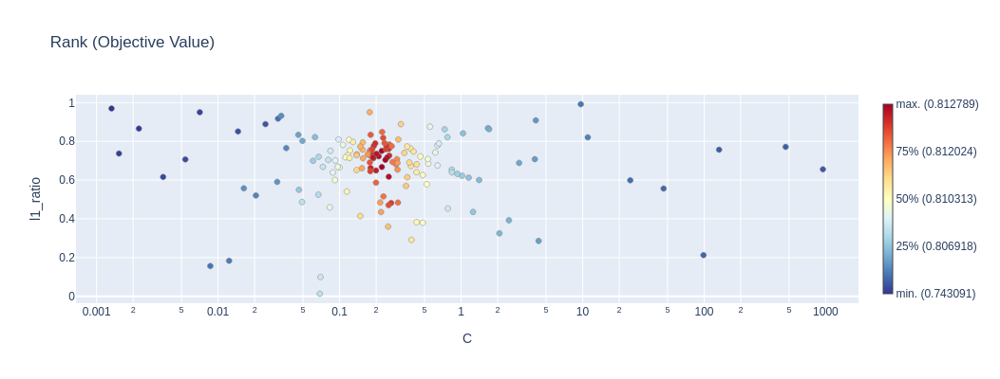

In [179]:
# Get parameters sorted by the importance values
importances = optuna.importance.get_param_importances(study, evaluator=evaluator)
params_sorted = list(importances.keys())

# Plot
fig = optuna.visualization.plot_rank(study, params=params_sorted)

fig.update_layout(
    width=400,  # Adjust width as needed
    height=400   # Adjust height as needed
)


fig.show()

In [79]:
plot_optimization_history(study)

In [80]:
print('AP: {}'.format(study.best_trial.value))
print("Best hyperparameters: {}".format(study.best_trial.params))

AP: 0.8127894820543534
Best hyperparameters: {'C': 0.2223891368789566, 'l1_ratio': 0.750608449750182}


In [33]:
# adding the results to the 'row' for future comparison.

trial_times = [trial.user_attrs["trial_time"] for trial in study.trials]

# Calculate average and standard deviation of trial times
mean_time = np.mean(trial_times)
std_time = np.std(trial_times)

rows.append({"Model": str(study_name).replace(str(DATA_FOLDER), "")[1:], "Average Precision": study.best_trial.value, "Time (mean)": round(mean_time,2) , "Time (sd)": round(std_time,2)})

## XGBooster <span style="opacity: 0.0;">3</span>

In [36]:
preprocessor = preprocessor_ohe_quantile

### Model with default HPs values to use as reference

In [39]:
start_time = time.time()

model = xgboost.XGBClassifier(
        random_state=RANDOM_STATE,
        n_jobs=-1
    )

# Create pipeline
pipeline_model = Pipeline([("preprocessor", preprocessor), ("model", model)])

score = cross_val_score(pipeline_model, X, y, n_jobs=-1, cv=custom_split, scoring='average_precision').mean()
total_time = time.time() - start_time
print(score, total_time)

0.790568111413433 4.1275670528411865


In [40]:
# adding the results to the 'row' for future comparison.
rows.append({"Model": "xgboost_default", "Average Precision": score, "Time (mean)": total_time , "Time (sd)": np.nan})

### Model to explore several HPs and their values

In [43]:
#save or load the Optuna analysis
study_name = str(DATA_FOLDER/"xgboost_round1")
storage_name = f"sqlite:///{study_name}.db"
study = optuna.create_study(direction='maximize', sampler=optuna.samplers.TPESampler(seed=RANDOM_STATE), study_name=study_name, storage=storage_name, load_if_exists=True)

[I 2025-02-03 07:44:36,368] Using an existing study with name '/home/alexhubbe/MEGA/data_science/portfolio/fraud_project/data/xgboost_round1' instead of creating a new one.


In [26]:
def objective(trial):
    """
    Define a search space for a model's hyperparameters and optimize it using cross-validation.
    """
    start_time = time.time()
    
    
    # Initialize the model with suggested hyperparameters
    model = xgboost.XGBClassifier(
        n_estimators = trial.suggest_int('n_estimators', 50, 500),
        max_depth = trial.suggest_int('max_depth', 0, 50),
        learning_rate = trial.suggest_float('learning_rate', 0.01, 1, log=True),
        subsample = trial.suggest_float('subsample', 0.5, 1.0),
        colsample_bytree = trial.suggest_float('colsample_bytree', 0.5, 1.0),
        gamma = trial.suggest_float('gamma', 0, 50),
        min_child_weight = trial.suggest_int('min_child_weight', 0, 50),
        reg_alpha = trial.suggest_float('reg_alpha', 0.0, 10.0),
        reg_lambda = trial.suggest_float('reg_lambda', 0.0, 10.0),
        colsample_bylevel = trial.suggest_float('colsample_bylevel', 0.01, 1.0),
        random_state=RANDOM_STATE,
        n_jobs=-1,
    )
    
    # Create pipeline
    pipeline_model = Pipeline([("preprocessor", preprocessor), ("model", model)])
    
    # Perform cross-validation
    score = cross_val_score(pipeline_model, X, y, n_jobs=-1, cv=custom_split, scoring='average_precision').mean()
    
    trial.set_user_attr("trial_time", time.time() - start_time)
    
    return score

# Optimize
study.optimize(objective, n_trials=n_trials)

[I 2024-12-15 11:20:11,785] Trial 0 finished with value: 0.7801649793522436 and parameters: {'n_estimators': 218, 'max_depth': 48, 'learning_rate': 0.29106359131330695, 'subsample': 0.7993292420985183, 'colsample_bytree': 0.5780093202212182, 'gamma': 7.799726016810133, 'min_child_weight': 2, 'reg_alpha': 8.661761457749352, 'reg_lambda': 6.011150117432088, 'colsample_bylevel': 0.710991852018085}. Best is trial 0 with value: 0.7801649793522436.
[I 2024-12-15 11:20:17,601] Trial 1 finished with value: 0.7571958844817549 and parameters: {'n_estimators': 59, 'max_depth': 49, 'learning_rate': 0.46225890010208287, 'subsample': 0.6061695553391381, 'colsample_bytree': 0.5909124836035503, 'gamma': 9.17022549267169, 'min_child_weight': 15, 'reg_alpha': 5.247564316322379, 'reg_lambda': 4.319450186421157, 'colsample_bylevel': 0.2983168487960615}. Best is trial 0 with value: 0.7801649793522436.
[I 2024-12-15 11:20:45,418] Trial 2 finished with value: 0.775573202419292 and parameters: {'n_estimators'

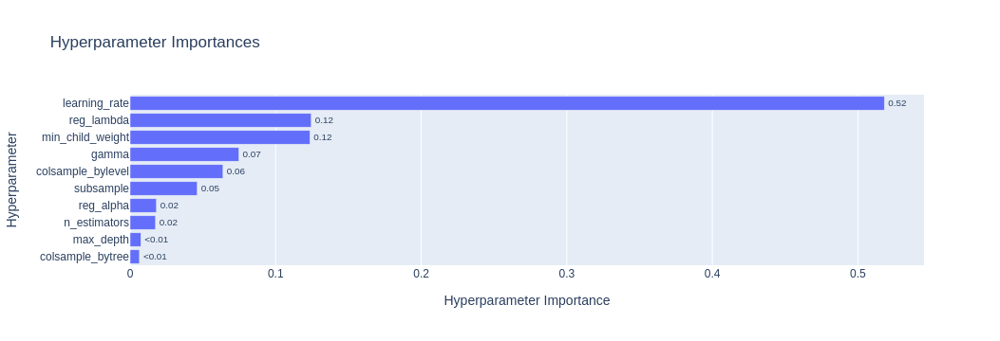

In [28]:
optuna.visualization.plot_param_importances(study, evaluator=evaluator)

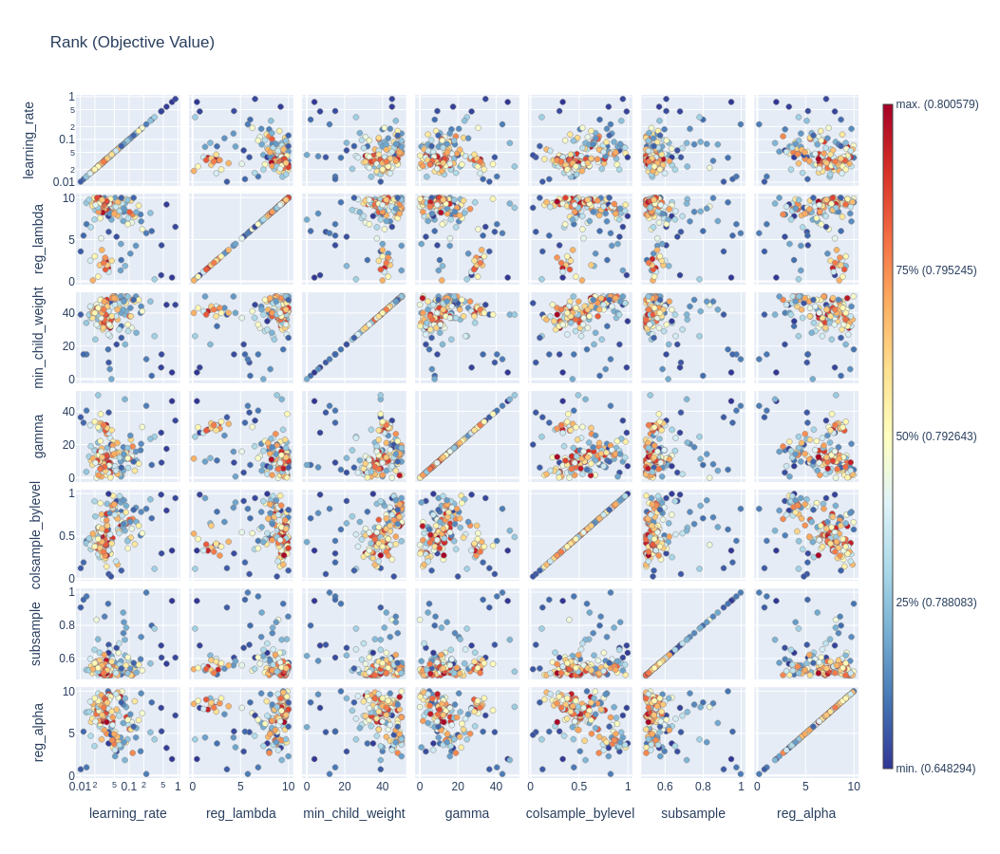

In [29]:
# Get parameters sorted by the importance values
importances = optuna.importance.get_param_importances(study, evaluator=evaluator)
params_sorted = list(importances.keys())

# Plot
fig = optuna.visualization.plot_rank(study, params=params_sorted[:7])

fig.update_layout(
    width=900,  # Adjust width as needed
    height=900   # Adjust height as needed
)


fig.show()

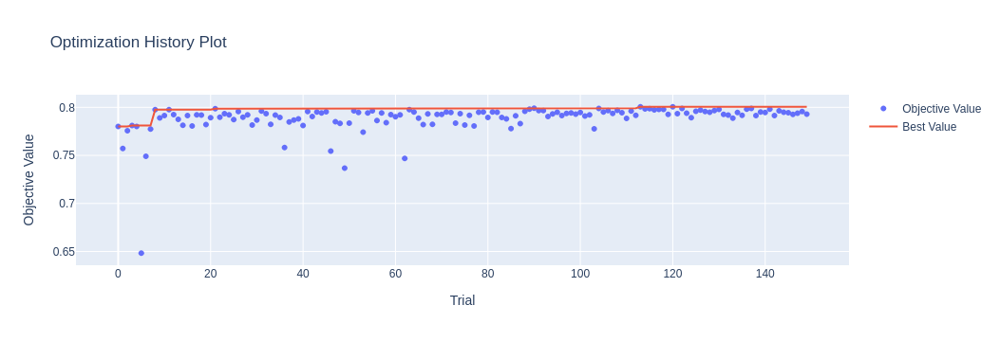

In [30]:
plot_optimization_history(study)

In [31]:
print('AP: {}'.format(study.best_trial.value))
print("Best hyperparameters: {}".format(study.best_trial.params))

AP: 0.8005792538827217
Best hyperparameters: {'n_estimators': 331, 'max_depth': 9, 'learning_rate': 0.025314675952347557, 'subsample': 0.5486991600329452, 'colsample_bytree': 0.5283968999931724, 'gamma': 9.848114950479918, 'min_child_weight': 41, 'reg_alpha': 7.893464807814313, 'reg_lambda': 9.98003607819156, 'colsample_bylevel': 0.478923560675153}


In [45]:
# adding the results to the 'row' for future comparison.

trial_times = [trial.user_attrs["trial_time"] for trial in study.trials]

# Calculate average and standard deviation of trial times
mean_time = np.mean(trial_times)
std_time = np.std(trial_times)

rows.append({"Model": str(study_name).replace(str(DATA_FOLDER), "")[1:], "Average Precision": study.best_trial.value, "Time (mean)": round(mean_time,2) , "Time (sd)": round(std_time,2)})

### Model with the most important HPs and adjusted HP values

In [48]:
#save or load the Optuna analysis
study_name = str(DATA_FOLDER/"xgboost_round2")
storage_name = f"sqlite:///{study_name}.db"
study = optuna.create_study(direction='maximize', sampler=optuna.samplers.TPESampler(seed=RANDOM_STATE), study_name=study_name, storage=storage_name, load_if_exists=True)

[I 2025-02-03 07:44:49,569] Using an existing study with name '/home/alexhubbe/MEGA/data_science/portfolio/fraud_project/data/xgboost_round2' instead of creating a new one.


In [36]:
def objective(trial):
    """
    Define a search space for a model's hyperparameters and optimize it using cross-validation.
    """
    start_time = time.time()
    
    
    # Initialize the model with suggested hyperparameters
    model = xgboost.XGBClassifier(
        learning_rate = trial.suggest_float('learning_rate', 0.01, 0.2, log=True),
        reg_lambda = trial.suggest_float('reg_lambda', 0.0, 20.0),
        min_child_weight = trial.suggest_int('min_child_weight', 25, 75),
        gamma = trial.suggest_float('gamma', 0, 40),
        colsample_bylevel = trial.suggest_float('colsample_bylevel', 0.01, 1.0),
        subsample = trial.suggest_float('subsample', 0.5, 0.65),
        random_state=RANDOM_STATE,
        n_jobs=-1,
    )
    
    # Create pipeline
    pipeline_model = Pipeline([("preprocessor", preprocessor), ("model", model)])
    
    # Perform cross-validation
    score = cross_val_score(pipeline_model, X, y, n_jobs=-1, cv=custom_split, scoring='average_precision').mean()
    
    trial.set_user_attr("trial_time", time.time() - start_time)
    
    return score

# Optimize
study.optimize(objective, n_trials=n_trials)

[I 2024-12-15 11:38:07,677] Trial 0 finished with value: 0.7823473383336017 and parameters: {'learning_rate': 0.030710573677773714, 'reg_lambda': 19.01428612819832, 'min_child_weight': 62, 'gamma': 23.946339367881464, 'colsample_bylevel': 0.16445845403801215, 'subsample': 0.5233991780504303}. Best is trial 0 with value: 0.7823473383336017.
[I 2024-12-15 11:38:13,497] Trial 1 finished with value: 0.7502475786236944 and parameters: {'learning_rate': 0.011900590783184251, 'reg_lambda': 17.323522915498703, 'min_child_weight': 55, 'gamma': 28.322903111841818, 'colsample_bylevel': 0.03037864935284442, 'subsample': 0.6454864778242991}. Best is trial 0 with value: 0.7823473383336017.
[I 2024-12-15 11:38:19,066] Trial 2 finished with value: 0.7943120796634151 and parameters: {'learning_rate': 0.12106896936002161, 'reg_lambda': 4.246782213565523, 'min_child_weight': 34, 'gamma': 7.336180394137353, 'colsample_bylevel': 0.31119982052994233, 'subsample': 0.5787134647448356}. Best is trial 2 with va

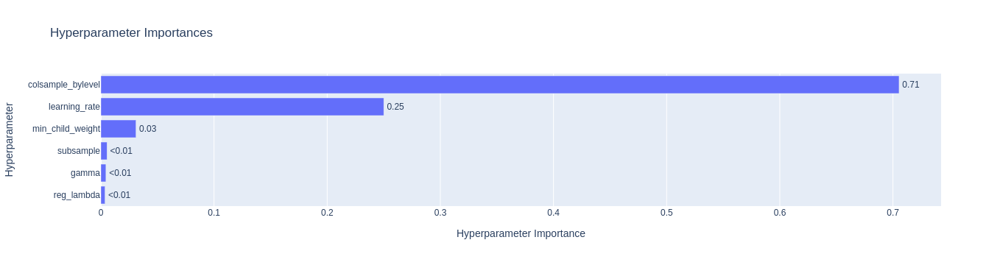

In [38]:
optuna.visualization.plot_param_importances(study, evaluator=evaluator)

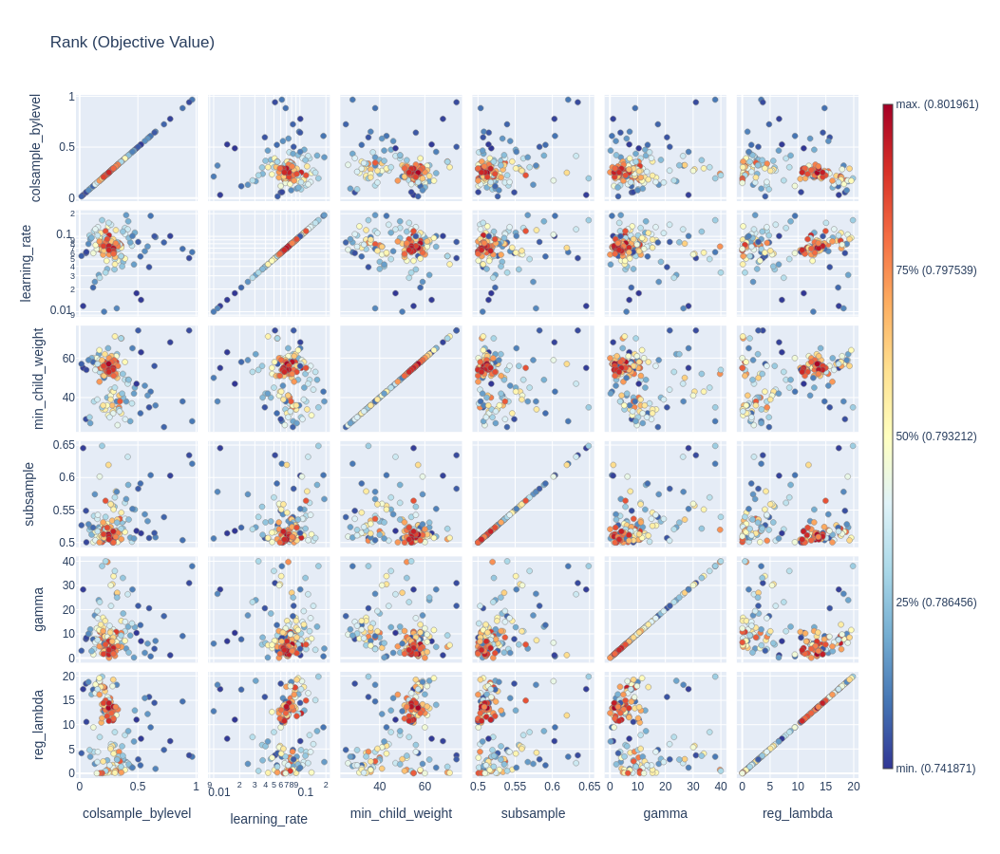

In [39]:
# Get parameters sorted by the importance values
importances = optuna.importance.get_param_importances(study, evaluator=evaluator)
params_sorted = list(importances.keys())

# Plot
fig = optuna.visualization.plot_rank(study, params=params_sorted[:7])

fig.update_layout(
    width=900,  # Adjust width as needed
    height=900   # Adjust height as needed
)


fig.show()

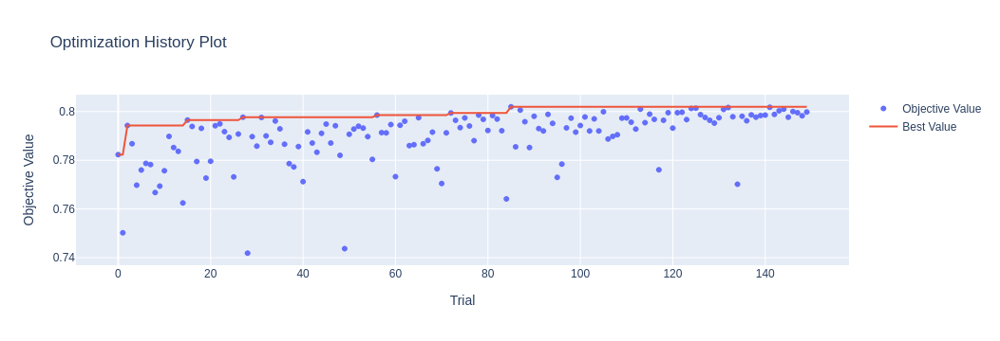

In [40]:
plot_optimization_history(study)

In [41]:
print('AP: {}'.format(study.best_trial.value))
print("Best hyperparameters: {}".format(study.best_trial.params))

AP: 0.8019614475604676
Best hyperparameters: {'learning_rate': 0.07721467376470967, 'reg_lambda': 13.099846322796305, 'min_child_weight': 57, 'gamma': 5.8715822241562865, 'colsample_bylevel': 0.21591830359431588, 'subsample': 0.504633886260343}


In [50]:
# adding the results to the 'row' for future comparison.

trial_times = [trial.user_attrs["trial_time"] for trial in study.trials]

# Calculate average and standard deviation of trial times
mean_time = np.mean(trial_times)
std_time = np.std(trial_times)

rows.append({"Model": str(study_name).replace(str(DATA_FOLDER), "")[1:], "Average Precision": study.best_trial.value, "Time (mean)": round(mean_time,2) , "Time (sd)": round(std_time,2)})

## Random Forest <span style="opacity: 0.0;">3</span>

In [53]:
preprocessor = preprocessor_ohe_robust_amount

### Model with default HPs values to use as reference

In [56]:
start_time = time.time()

model = RandomForestClassifier(
        random_state=RANDOM_STATE,
        n_jobs=-1
    )

# Create pipeline
pipeline_model = Pipeline([("preprocessor", preprocessor), ("model", model)])

score = cross_val_score(pipeline_model, X, y, n_jobs=-1, cv=custom_split, scoring='average_precision').mean()
total_time = time.time() - start_time
print(score, total_time)

0.773160718318734 23.718677282333374


In [57]:
# adding the results to the 'row' for future comparison.
rows.append({"Model": "random_forest_default", "Average Precision": score, "Time (mean)": total_time , "Time (sd)": np.nan})

### Model to explore several HPs and their values

In [58]:
#save or load the Optuna analysis
study_name = str(DATA_FOLDER/"random_forest_round1")
storage_name = f"sqlite:///{study_name}.db"
study = optuna.create_study(direction='maximize', sampler=optuna.samplers.TPESampler(seed=RANDOM_STATE), study_name=study_name, storage=storage_name, load_if_exists=True)

[I 2025-02-03 07:45:24,786] Using an existing study with name '/home/alexhubbe/MEGA/data_science/portfolio/fraud_project/data/random_forest_round1' instead of creating a new one.


In [50]:
def objective(trial):
    """
    Define a search space for a model's hyperparameters and optimize it using cross-validation.
    """
    start_time = time.time()

    # Initialize the Random Forest model with suggested hyperparameters
    model = RandomForestClassifier(
        n_estimators=trial.suggest_int('n_estimators', 50, 300), 
        max_depth=trial.suggest_int('max_depth', 1, 50),         
        min_samples_split=trial.suggest_int('min_samples_split', 2, 20), 
        min_samples_leaf=trial.suggest_int('min_samples_leaf', 1, 5),    
        max_features=trial.suggest_categorical('max_features', ['sqrt', 'log2', None]),
        random_state=RANDOM_STATE,
        n_jobs=-1
    )

    # Create pipeline
    pipeline_model = Pipeline([("preprocessor", preprocessor), ("model", model)])
    
    # Perform cross-validation
    score = cross_val_score(pipeline_model, X, y, n_jobs=-1, cv=custom_split, scoring='average_precision').mean()
    
    trial.set_user_attr("trial_time", time.time() - start_time)
    
    return score

# Optimize
study.optimize(objective, n_trials=n_trials)

[I 2024-12-15 12:02:10,862] Trial 0 finished with value: 0.7804295513801108 and parameters: {'n_estimators': 144, 'max_depth': 48, 'min_samples_split': 15, 'min_samples_leaf': 3, 'max_features': 'sqrt'}. Best is trial 0 with value: 0.7804295513801108.
[I 2024-12-15 12:03:07,101] Trial 1 finished with value: 0.7813786372709052 and parameters: {'n_estimators': 267, 'max_depth': 31, 'min_samples_split': 15, 'min_samples_leaf': 1, 'max_features': 'sqrt'}. Best is trial 1 with value: 0.7813786372709052.
[I 2024-12-15 12:04:35,532] Trial 2 finished with value: 0.7283475514665747 and parameters: {'n_estimators': 95, 'max_depth': 10, 'min_samples_split': 7, 'min_samples_leaf': 3, 'max_features': None}. Best is trial 1 with value: 0.7813786372709052.
[I 2024-12-15 12:04:53,746] Trial 3 finished with value: 0.7733608993945642 and parameters: {'n_estimators': 85, 'max_depth': 15, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_features': 'sqrt'}. Best is trial 1 with value: 0.7813786372709052

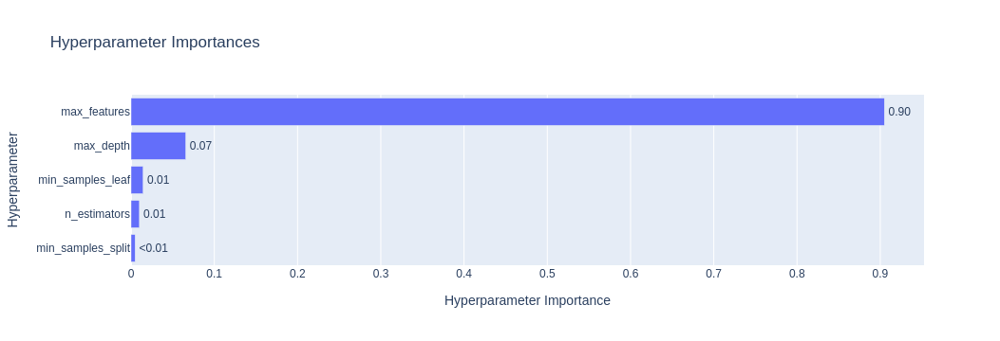

In [52]:
optuna.visualization.plot_param_importances(study, evaluator=evaluator)

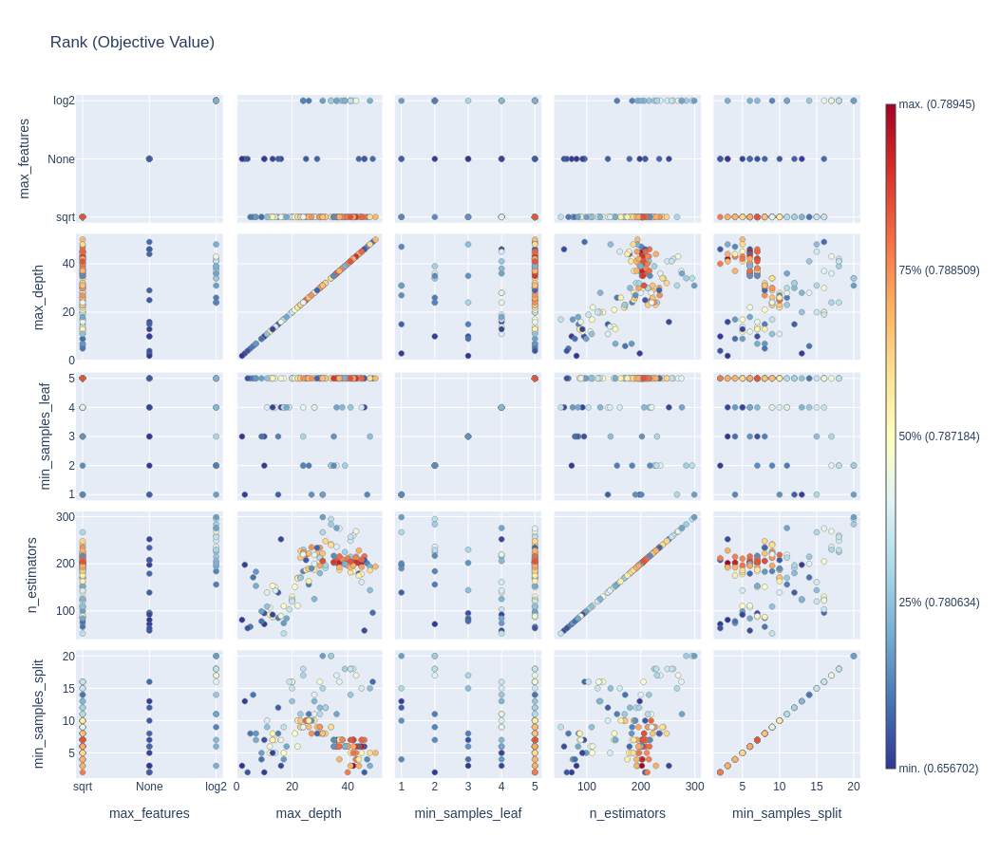

In [53]:
# Get parameters sorted by the importance values
importances = optuna.importance.get_param_importances(study, evaluator=evaluator)
params_sorted = list(importances.keys())

# Plot
fig = optuna.visualization.plot_rank(study, params=params_sorted[:7])

fig.update_layout(
    width=900,  # Adjust width as needed
    height=900   # Adjust height as needed
)


fig.show()

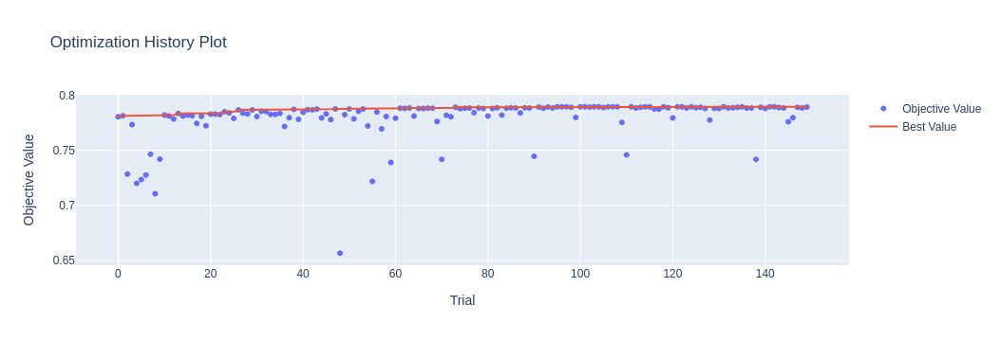

In [54]:
plot_optimization_history(study)

In [55]:
print('AP: {}'.format(study.best_trial.value))
print("Best hyperparameters: {}".format(study.best_trial.params))

AP: 0.7894495415257483
Best hyperparameters: {'n_estimators': 202, 'max_depth': 44, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_features': 'sqrt'}


In [59]:
# adding the results to the 'row' for future comparison.

trial_times = [trial.user_attrs["trial_time"] for trial in study.trials]

# Calculate average and standard deviation of trial times
mean_time = np.mean(trial_times)
std_time = np.std(trial_times)

rows.append({"Model": str(study_name).replace(str(DATA_FOLDER), "")[1:], "Average Precision": study.best_trial.value, "Time (mean)": round(mean_time,2) , "Time (sd)": round(std_time,2)})

### Model with the most important HPs and adjusted HP values

In [61]:
study_name = str(DATA_FOLDER/"random_forest_round2")
storage_name = f"sqlite:///{study_name}.db"
study = optuna.create_study(direction='maximize', sampler=optuna.samplers.TPESampler(seed=RANDOM_STATE), study_name=study_name, storage=storage_name, load_if_exists=True)

[I 2025-02-03 07:45:25,199] Using an existing study with name '/home/alexhubbe/MEGA/data_science/portfolio/fraud_project/data/random_forest_round2' instead of creating a new one.


In [61]:
def objective(trial):
    """
    Define a search space for a model's hyperparameters and optimize it using cross-validation.
    """
    start_time = time.time()

    # Initialize the Random Forest model with suggested hyperparameters
    model = RandomForestClassifier(
        n_estimators=trial.suggest_int('n_estimators', 200, 400), 
        max_depth=trial.suggest_int('max_depth', 1, 50),         
        min_samples_split=trial.suggest_int('min_samples_split', 2, 10), 
        min_samples_leaf=trial.suggest_int('min_samples_leaf', 3, 5),    
        max_features='log2',
        random_state=RANDOM_STATE,
        n_jobs=-1
    )

    # Create pipeline
    pipeline_model = Pipeline([("preprocessor", preprocessor), ("model", model)])
    
    # Perform cross-validation
    score = cross_val_score(pipeline_model, X, y, n_jobs=-1, cv=custom_split, scoring='average_precision').mean()
    
    trial.set_user_attr("trial_time", time.time() - start_time)
    
    return score

# Optimize
study.optimize(objective, n_trials=n_trials)

[I 2024-12-15 14:26:24,238] Trial 0 finished with value: 0.7824824699447912 and parameters: {'n_estimators': 275, 'max_depth': 48, 'min_samples_split': 8, 'min_samples_leaf': 4}. Best is trial 0 with value: 0.7824824699447912.
[I 2024-12-15 14:26:49,289] Trial 1 finished with value: 0.7746520859835864 and parameters: {'n_estimators': 231, 'max_depth': 8, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 0 with value: 0.7824824699447912.
[I 2024-12-15 14:27:42,743] Trial 2 finished with value: 0.7833175945842508 and parameters: {'n_estimators': 320, 'max_depth': 36, 'min_samples_split': 2, 'min_samples_leaf': 5}. Best is trial 2 with value: 0.7833175945842508.
[I 2024-12-15 14:28:41,743] Trial 3 finished with value: 0.7767901328290655 and parameters: {'n_estimators': 367, 'max_depth': 11, 'min_samples_split': 3, 'min_samples_leaf': 3}. Best is trial 2 with value: 0.7833175945842508.
[I 2024-12-15 14:29:25,903] Trial 4 finished with value: 0.7768021057706792 and parameters: {

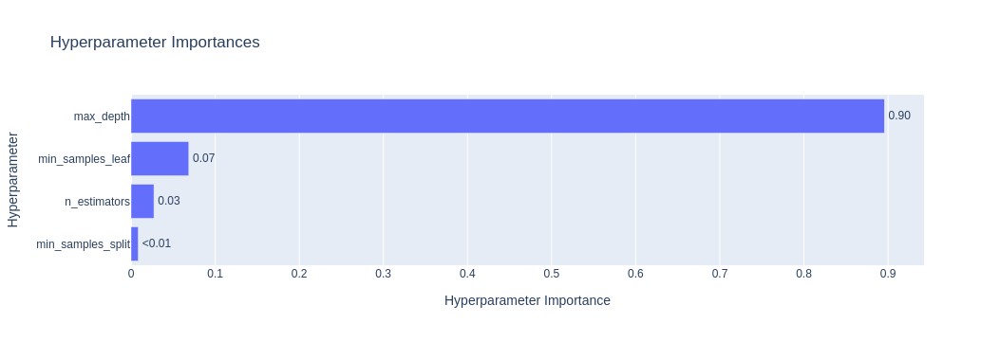

In [63]:
optuna.visualization.plot_param_importances(study, evaluator=evaluator)

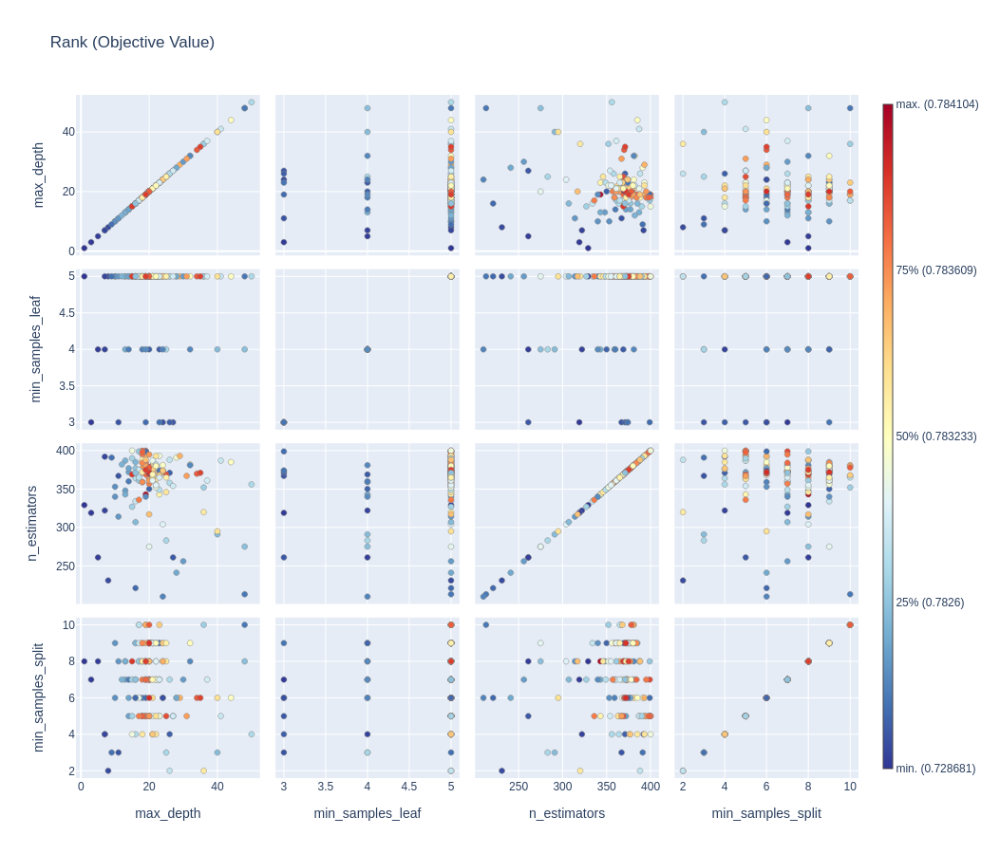

In [64]:
# Get parameters sorted by the importance values
importances = optuna.importance.get_param_importances(study, evaluator=evaluator)
params_sorted = list(importances.keys())

# Plot
fig = optuna.visualization.plot_rank(study, params=params_sorted[:7])

fig.update_layout(
    width=900,  # Adjust width as needed
    height=900   # Adjust height as needed
)


fig.show()

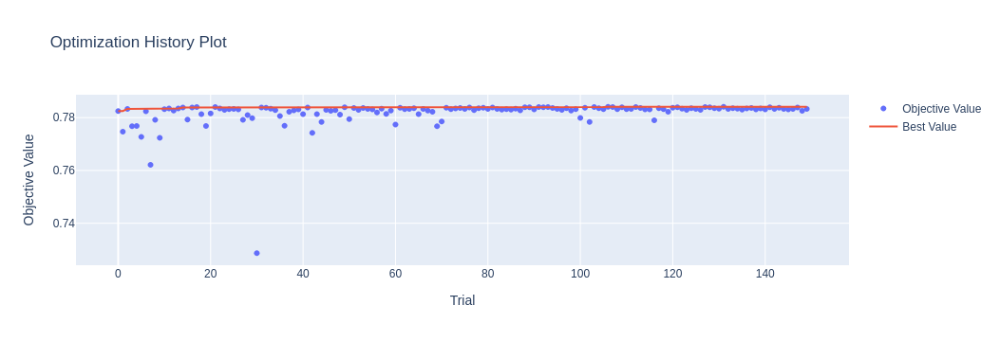

In [65]:
plot_optimization_history(study)

In [66]:
print('AP: {}'.format(study.best_trial.value))
print("Best hyperparameters: {}".format(study.best_trial.params))

AP: 0.784103617321633
Best hyperparameters: {'n_estimators': 371, 'max_depth': 20, 'min_samples_split': 9, 'min_samples_leaf': 5}


In [67]:
# adding the results to the 'row' for future comparison.

trial_times = [trial.user_attrs["trial_time"] for trial in study.trials]

# Calculate average and standard deviation of trial times
mean_time = np.mean(trial_times)
std_time = np.std(trial_times)

rows.append({"Model": str(study_name).replace(str(DATA_FOLDER), "")[1:], "Average Precision": study.best_trial.value, "Time (mean)": round(mean_time,2) , "Time (sd)": round(std_time,2)})

# Final Results

In [83]:
#df with the final results of the analyses
df_results_model_hp = pd.DataFrame(rows)
df_results_model_hp = df_results_model_hp.sort_values(by='Average Precision', ascending=False)
df_results_model_hp = df_results_model_hp.reset_index(drop=True)
# # Calculate the relative decrease percentage for each row and add it as a new column
df_results_model_hp['Relative Decrease (%)'] = round((1 - df_results_model_hp['Average Precision'] / df_results_model_hp['Average Precision'].iloc[0]) * 100, 2)
df_results_model_hp = df_results_model_hp[['Model', 'Average Precision', 'Relative Decrease (%)', 'Time (mean)', 'Time (sd)']]

df_results_model_hp = df_results_model_hp.rename(columns={
    'Time (mean)': 'Mean Time (s)',
    'Time (sd)': 'Sd Time (s)'
})

df_results_model_hp['Mean Time (s)'] = round(df_results_model_hp['Mean Time (s)'],2)

df_results_model_hp

,Model,Average Precision,Relative Decrease (%),Mean Time (s),Sd Time (s)
0,logistic_regression_round1,0.812789,0.00,22.39,12.21
1,logistic_regression_default,0.803806,1.11,2.43,NaN
2,xgboost_round2,0.801961,1.33,6.60,18.57
3,xgboost_round1,0.800579,1.50,6.38,3.08
4,xgboost_default,0.790568,2.73,4.13,NaN
5,random_forest_round1,0.789450,2.87,56.24,61.30
6,random_forest_round2,0.784104,3.53,65.41,31.09
7,random_forest_default,0.773161,4.88,23.72,NaN


## <span style="color:red;">Remarks:</span>
- Logistic Regression is the best approach. The choice between a fine-tuned model and the default model depends on the trade-off between time and Average Precision. The default model is ~8 times faster than the fine-tuned one, but its Average Precision is ~1% lower.
    - Since time is crucial in the Credit Card Fraud Detection scenario, I will deploy the default model.

# Deploy

In [78]:
X_train = X.iloc[train_indices]
y_train = y[train_indices]

preprocessor = preprocessor_ohe_quantile

best_trial = study.best_trial
best_params = best_trial.params
model = LogisticRegression(
        max_iter=1000,
        random_state=RANDOM_STATE,
        n_jobs=-1
    )


# Create pipeline
pipeline_model = Pipeline([("preprocessor", preprocessor), ("model", model)])

pipeline_model.fit(X_train,y_train)

joblib.dump(pipeline_model, DEPLOYED_MODEL)

['/home/alexhubbe/MEGA/data_science/portfolio/fraud_project/models/best_model_pkl']

# References

Le Borgne, Y.-A., Siblini, W., Lebichot, B., & Bontempi, G. (2022). Reproducible Machine Learning for Credit Card Fraud Detection—Practical Handbook. Université Libre de Bruxelles.

Fernández, A., García, S., Galar, M., Prati, R. C., Krawczyk, B., & Herrera, F. (2018). Learning from imbalanced data sets (Vol. 10, No. 2018). Cham: Springer.